In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras

import os

# Data preparation and exploration

In [ ]:
from urllib import request

data_url = ('https://storage.googleapis.com/tensorflow-1-public/course2/week3/'
            'horse-or-human.zip')
local_zip = os.path.join('data', 'horse-or-human.zip')
response = request.urlretrieve(data_url, local_zip)
response

In [11]:
import zipfile

train_dir = os.path.join('data', 'horse-or-human')
with zipfile.ZipFile(local_zip, 'r') as zip_ref:
    zip_ref.extractall(train_dir)

In [2]:
import os

train_horse_dir = os.path.join(train_dir, 'horses')
train_human_dir = os.path.join(train_dir, 'humans')

train_horse_names = os.listdir(train_horse_dir)
train_human_names = os.listdir(train_human_dir)

print(f'There are {len(train_horse_names)} horse images.')
print(train_horse_names[:10])
print()
print(f'There are {len(train_human_names)} human images.')
print(train_human_names[:10])

There are 500 horse images.
['horse01-0.png', 'horse01-1.png', 'horse01-2.png', 'horse01-3.png', 'horse01-4.png', 'horse01-5.png', 'horse01-6.png', 'horse01-7.png', 'horse01-8.png', 'horse01-9.png']

There are 527 human images.
['human01-00.png', 'human01-01.png', 'human01-02.png', 'human01-03.png', 'human01-04.png', 'human01-05.png', 'human01-06.png', 'human01-07.png', 'human01-08.png', 'human01-09.png']


In [3]:
def view_horse_human(start_ind, nrows=4, ncols=4):
    fig, axs = plt.subplots(nrows, ncols, figsize=[4*ncols, 4*nrows])
    
    if nrows % 2 == 1:
        nrows += 1
    nimgs = (nrows // 2) * ncols
    horse_dirs = [os.path.join(train_horse_dir, file)
                  for file in train_horse_names[start_ind : start_ind+nimgs]]
    human_dirs = [os.path.join(train_human_dir, file)
                  for file in train_human_names[start_ind : start_ind+nimgs]]
    
    for ax, file in zip(axs.flatten(), horse_dirs+human_dirs):
        img = plt.imread(file)
        ax.imshow(img)
        ax.axis('off')

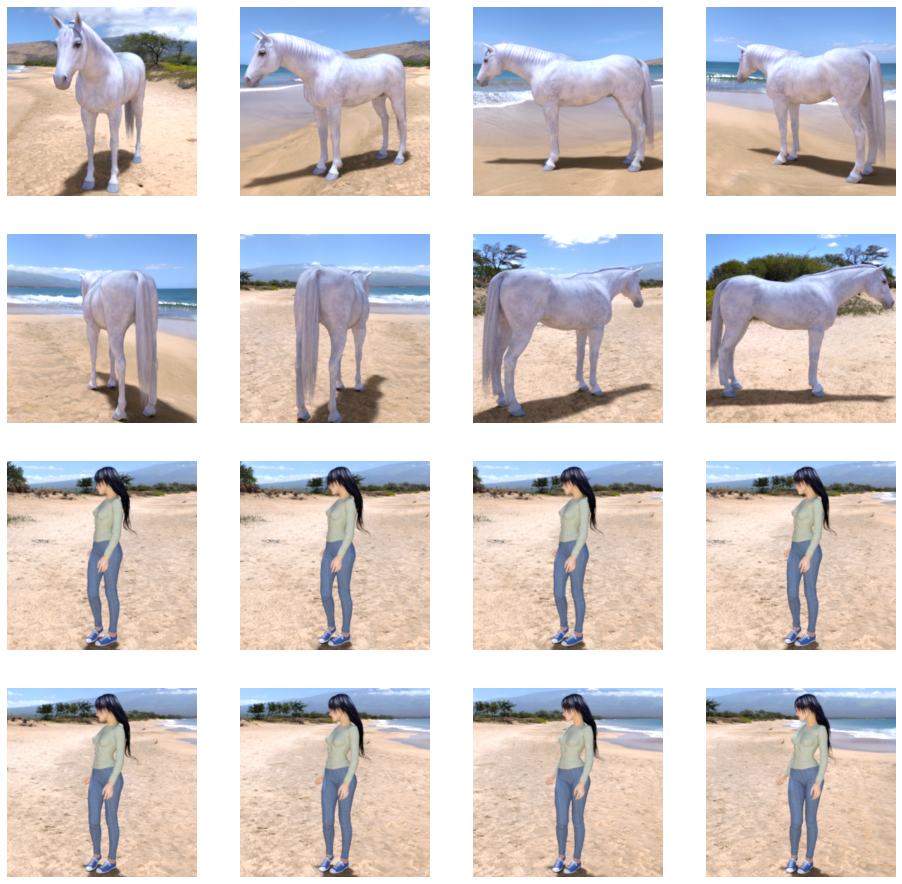

In [4]:
view_horse_human(0)

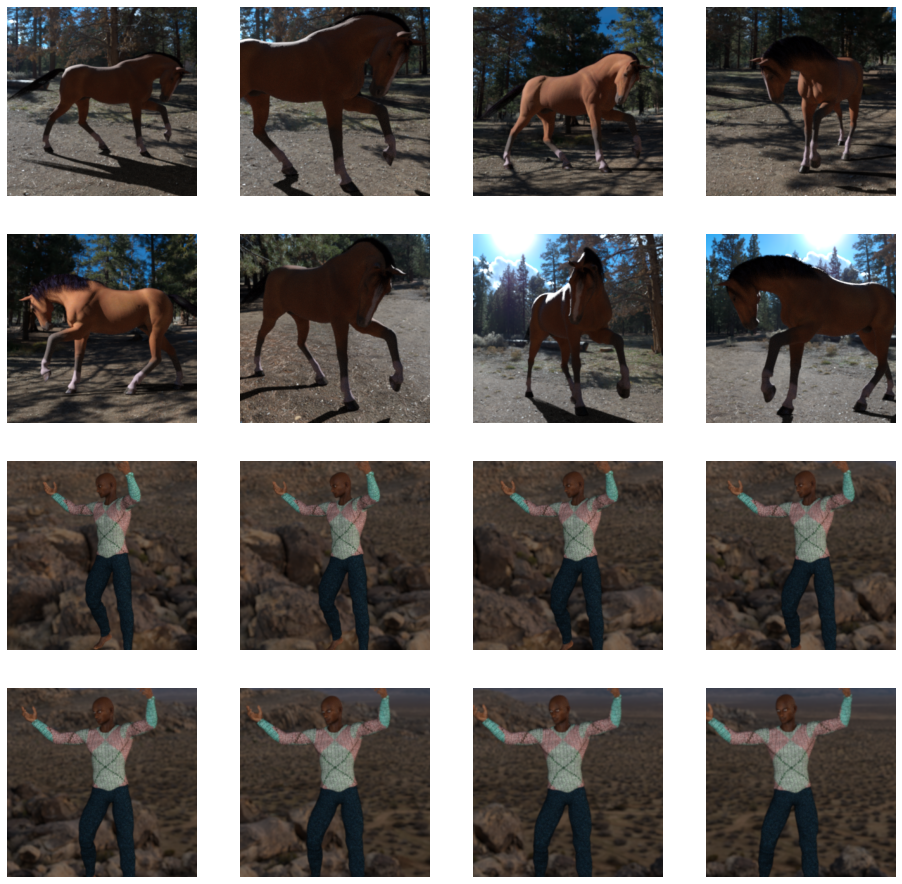

In [5]:
view_horse_human(100)

In [6]:
from keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(rescale=1/255)

train_data = train_datagen.flow_from_directory(
    train_dir,
    target_size=(300, 300),
    batch_size=128,
    class_mode='binary'
)

Found 1027 images belonging to 2 classes.


# Neural network building, training, and testing

In [16]:
model = keras.Sequential([
    keras.layers.Conv2D(16, (3, 3), input_shape=(300, 300, 3), activation='relu'),
    keras.layers.MaxPooling2D(2, 2),
    keras.layers.Conv2D(32, (3, 3), activation='relu'),
    keras.layers.MaxPooling2D(2, 2),
    keras.layers.Conv2D(64, (3, 3), activation='relu'),
    keras.layers.MaxPooling2D(2, 2),
    keras.layers.Conv2D(64, (3, 3), activation='relu'),
    keras.layers.MaxPooling2D(2, 2),
    keras.layers.Conv2D(64, (3, 3), activation='relu'),
    keras.layers.MaxPooling2D(2, 2),
    keras.layers.Flatten(),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 298, 298, 16)      448       
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 149, 149, 16)     0         
 2D)                                                             
                                                                 
 conv2d_6 (Conv2D)           (None, 147, 147, 32)      4640      
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 73, 73, 32)       0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 71, 71, 64)        18496     
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 35, 35, 64)      

In [17]:
model.compile(
    loss='binary_crossentropy',
    optimizer=keras.optimizers.RMSprop(learning_rate=0.001),
    metrics=['accuracy']
)

In [18]:
%%time

model.fit(
    train_data,
    steps_per_epoch=8,
    epochs=15,
    verbose=1
)

Epoch 1/15
8/8 [==============================] - 43s 5s/step - loss: 0.7567 - accuracy: 0.4980
Epoch 2/15
8/8 [==============================] - 39s 5s/step - loss: 0.6733 - accuracy: 0.6340
Epoch 3/15
8/8 [==============================] - 39s 5s/step - loss: 0.8971 - accuracy: 0.7353
Epoch 4/15
8/8 [==============================] - 41s 5s/step - loss: 0.6389 - accuracy: 0.7753
Epoch 5/15
8/8 [==============================] - 47s 6s/step - loss: 0.2998 - accuracy: 0.8799
Epoch 6/15
8/8 [==============================] - 46s 5s/step - loss: 0.4508 - accuracy: 0.8454
Epoch 7/15
8/8 [==============================] - 44s 5s/step - loss: 0.1962 - accuracy: 0.9433
Epoch 8/15
8/8 [==============================] - 45s 5s/step - loss: 0.2102 - accuracy: 0.9355
Epoch 9/15
8/8 [==============================] - 53s 7s/step - loss: 0.1699 - accuracy: 0.9404
Epoch 10/15
8/8 [==============================] - 45s 5s/step - loss: 0.0651 - accuracy: 0.9833
Epoch 11/15
8/8 [======================

In [171]:
def pred_horse_human(model, imgnp, img_name='this'):
    classes = model.predict(imgnp[np.newaxis, ...])
    
    fig, ax = plt.subplots()
    ax.imshow(imgnp)
    ax.axis('off')
    ax.set_title(
        ('P(human) = %.2g\n' % classes[0, 0])
        + img_name + ' is a ' + ('human' if classes[0, 0] >= 0.5 else 'horse')
    )

def pred_horse_human_dir(model, test_dir=os.path.join('data', 'horse-or-human-test')):
    img_names = [file_name for file_name in os.listdir(test_dir)
                           if file_name.endswith(('.png', '.jpg'))]
    for img_name in img_names:
        img = keras.utils.load_img(os.path.join(test_dir, img_name),
                                   target_size=model.input_shape[1:3])
        imgnp = keras.utils.img_to_array(img)/255
        pred_horse_human(model, imgnp, img_name)

1/1 [==============================] - 0s 33ms/step


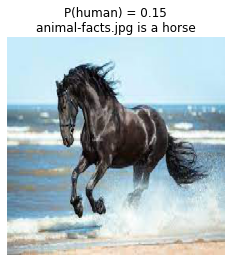

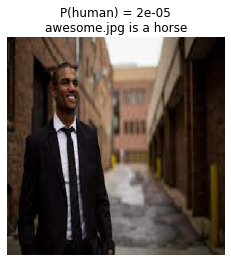

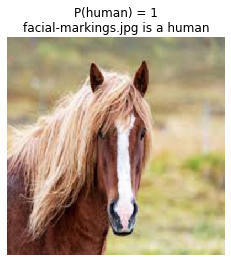

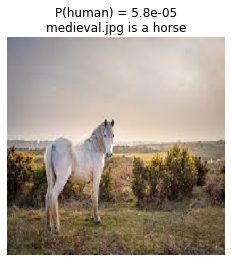

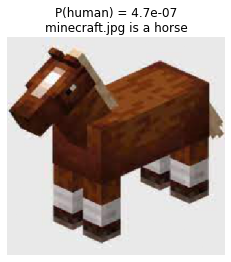

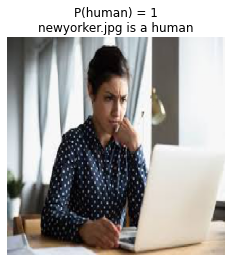

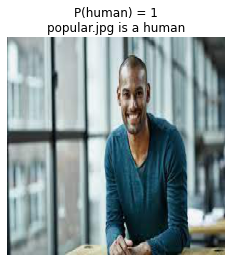

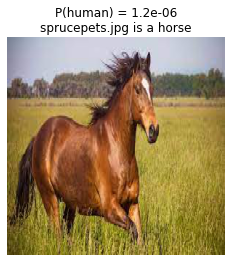

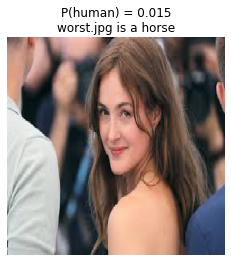

In [172]:
pred_horse_human_dir(model)

# Introspection of convolution layers

In [125]:
def conv_layers(model):
    layers_out = [l.output for l in model.layers if len(l.output_shape) == 4]
    return keras.models.Model(inputs=model.input, outputs=layers_out)

def view_layers_output(layers_model, img, fig_x = 20, n_fil_row = 16):
    out = layers_model.predict(img[np.newaxis, ...])
    
    for l_out, l in zip(out, layers_model.outputs):
        n_fil = l_out.shape[3]
        side = l_out.shape[1]
        
        stacked = np.zeros((side, side*n_fil))
        for i in range(n_fil):
            x = l_out[0, :, :, i]
            x -= x.mean()
            if x.std() > 1e-6:
                x /= x.std()
            x = np.clip(x, -2, 2)
            stacked[:, i*side : (i+1)*side] = x
            
        nrow = n_fil // n_fil_row
        stacked = np.vstack(np.split(stacked, nrow, axis=1))
        
        fig, ax = plt.subplots(figsize=(fig_x, fig_x/n_fil_row*nrow))
        ax.imshow(stacked, cmap='viridis')
        ax.axis('off')
        ax.set_title(l.name + ': ' + str(l.shape))

In [177]:
def get_layers_viewer(model):
    conv_model = conv_layers(model)
    
    def viewer(img_id, img_dir):
        if img_dir == 'test':
            file = os.path.join('horse-or-human-test', img_id)
        elif img_dir == 'horse':
            img_id = train_horse_names[img_id]
            file = os.path.join(train_horse_dir, img_id)
        elif img_dir == 'human':
            img_id = train_human_names[img_id]
            file = os.path.join(train_human_dir, img_id)
        else:
            raise Exception('No such image directory as ' + img_dir)
        
        img = keras.utils.load_img(file, target_size=model.input_shape[1:3])
        imgnp = keras.utils.img_to_array(img)/255
        
        pred_horse_human(model, imgnp, img_id)
        view_layers_output(conv_model, imgnp)
    
    return viewer

view_hh_layers = get_layers_viewer(model)

1/1 [==============================] - 0s 148ms/step


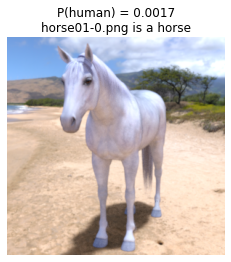

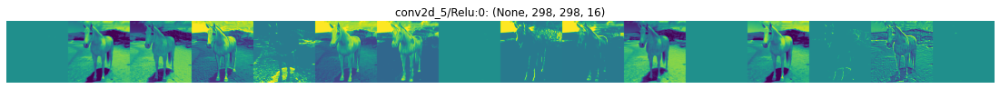

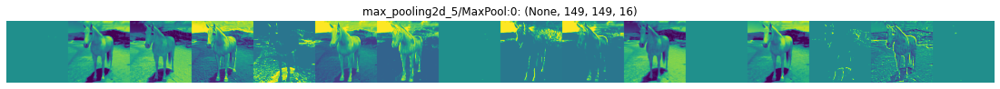

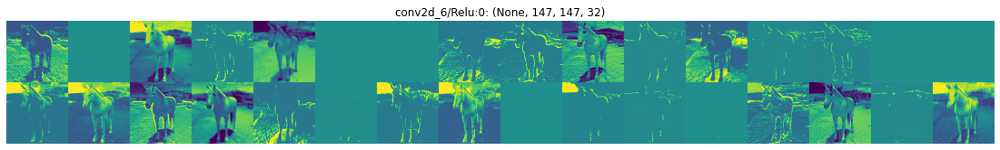

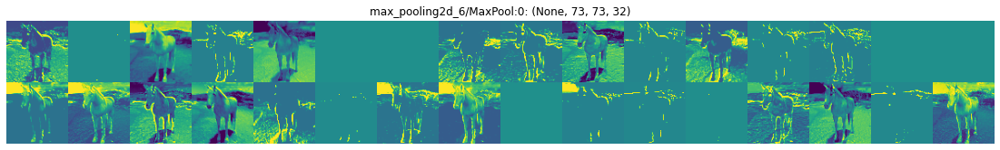

...

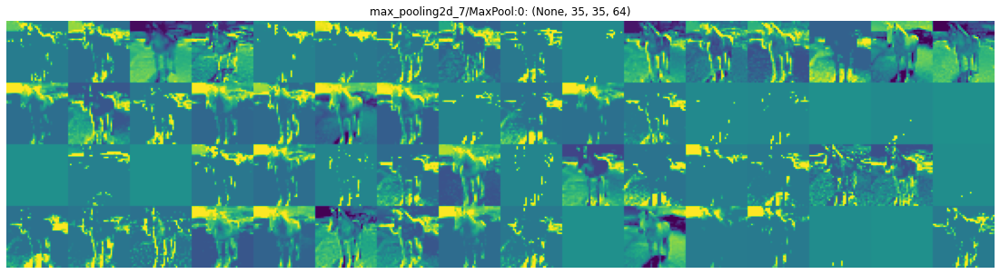

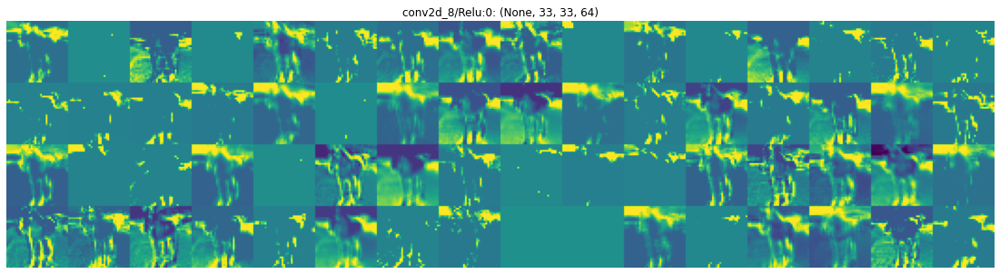

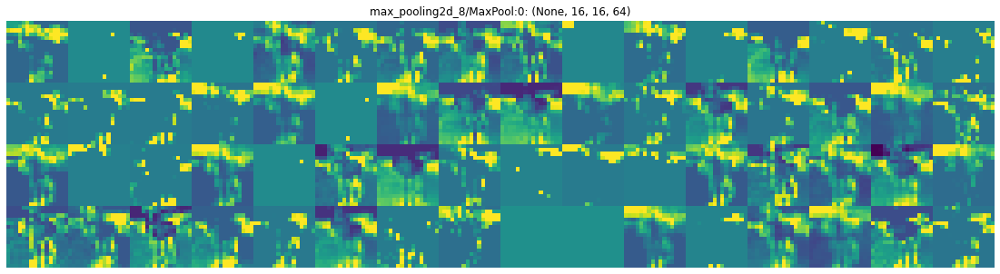

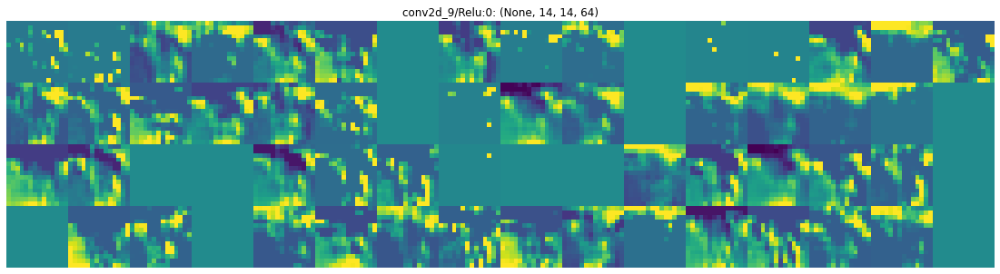

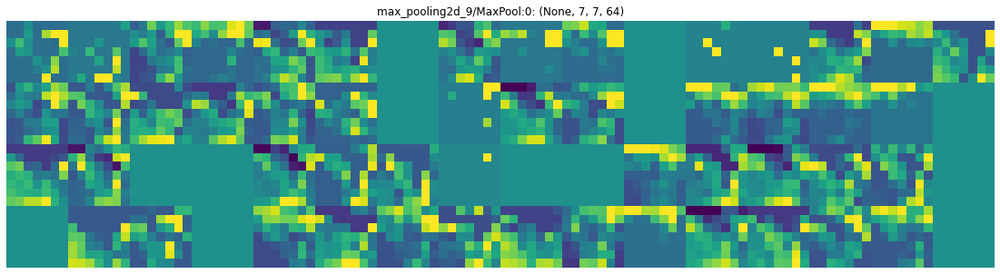

In [182]:
view_hh_layers(0, 'horse')

1/1 [==============================] - 0s 29ms/step


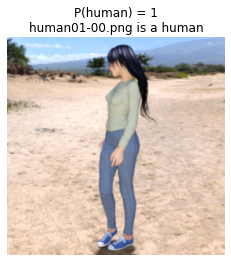

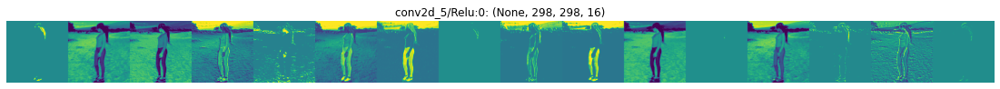

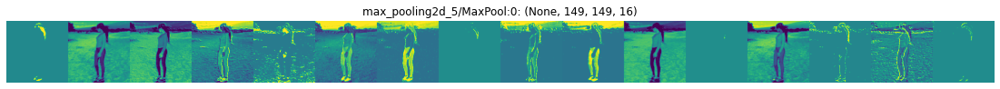

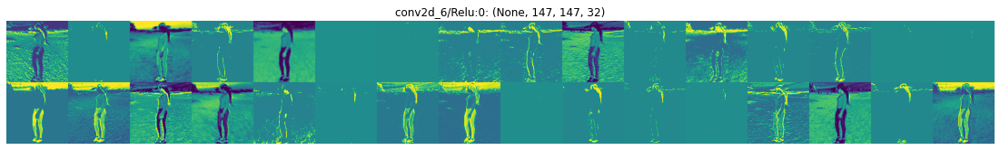

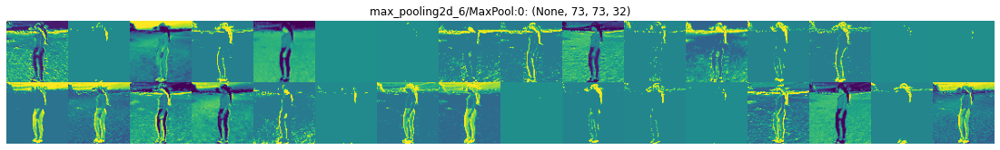

...

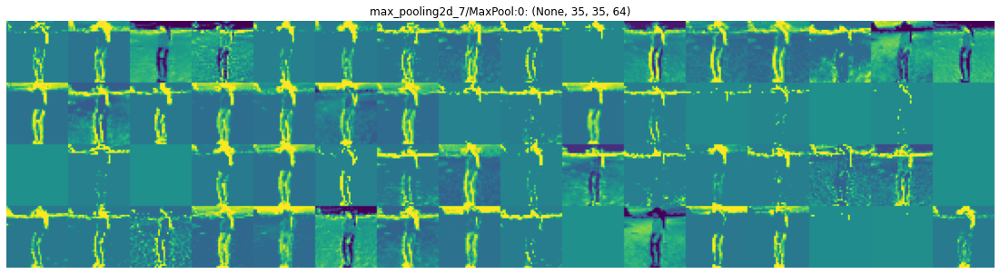

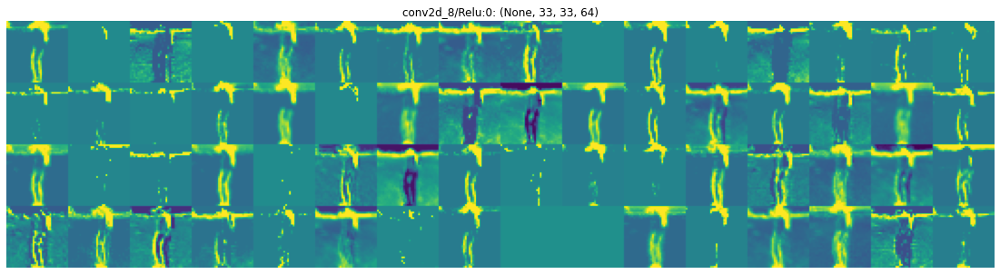

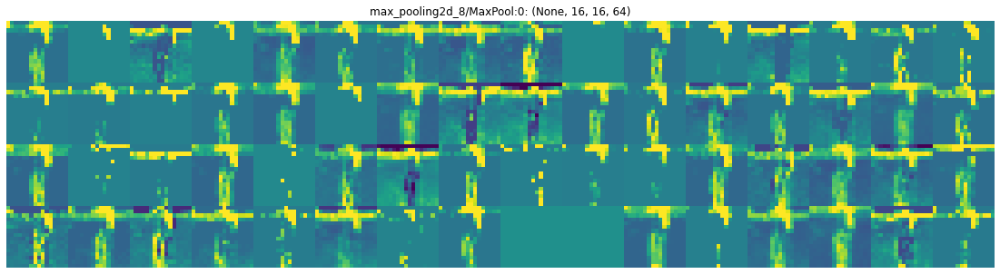

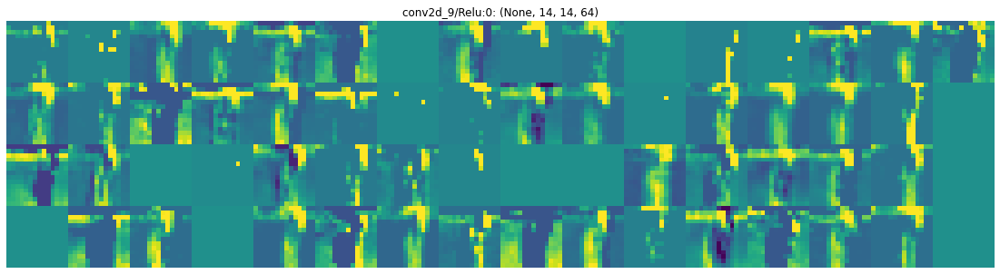

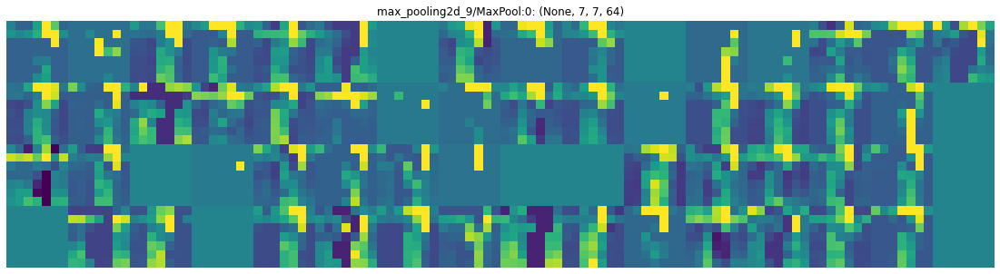

In [128]:
view_hh_layers(0, 'human')

1/1 [==============================] - 0s 30ms/step


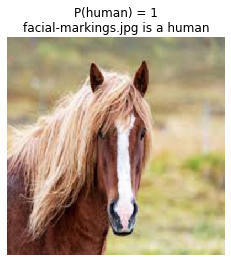

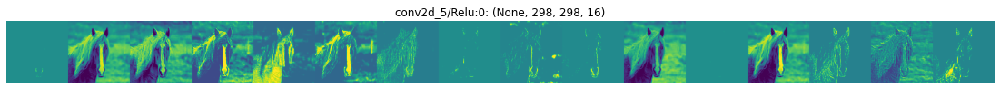

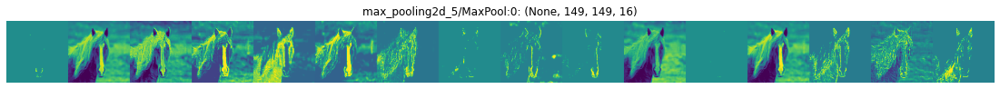

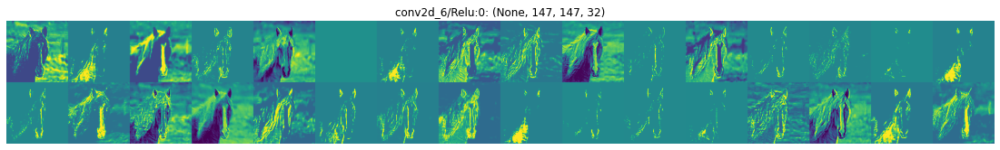

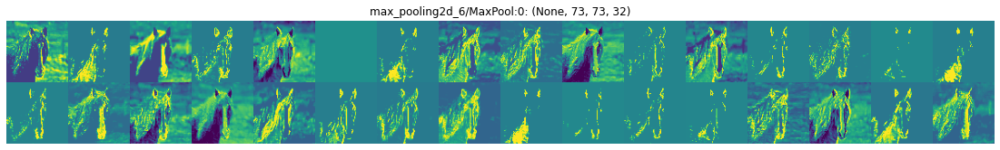

...

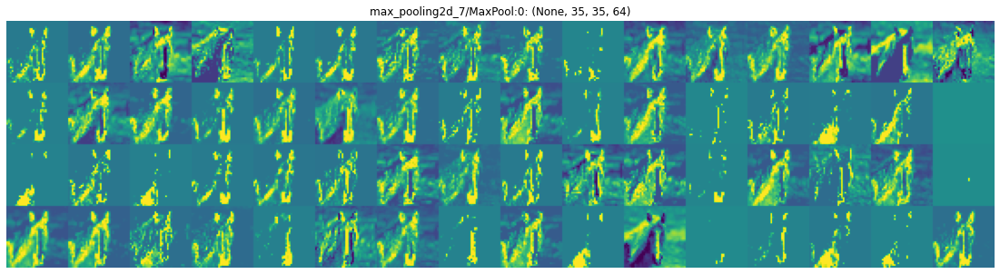

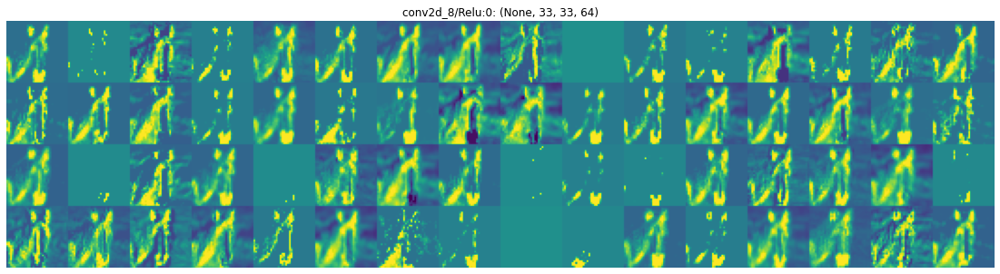

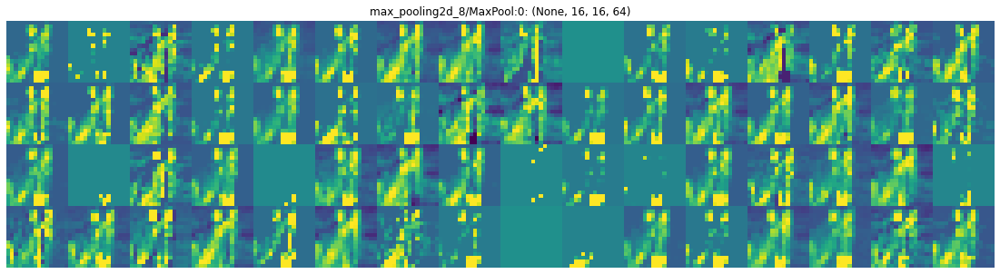

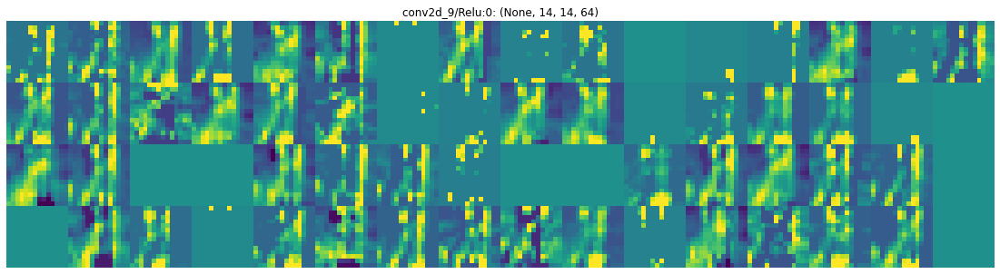

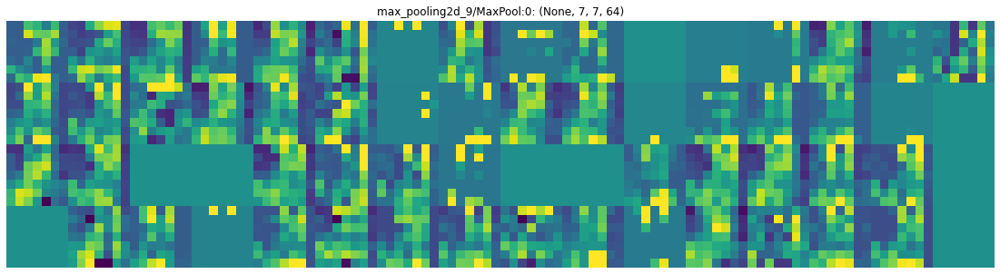

In [129]:
view_hh_layers('facial-markings.jpg', 'test')

1/1 [==============================] - 0s 49ms/step


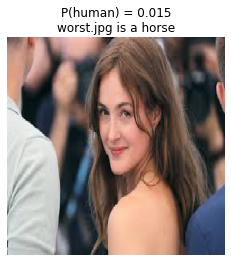

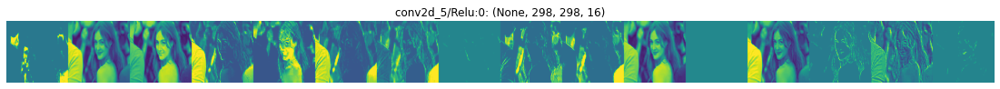

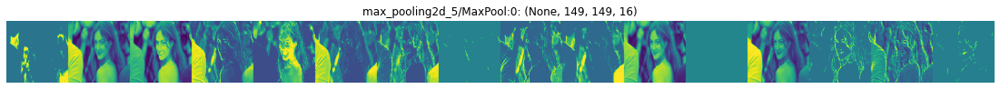

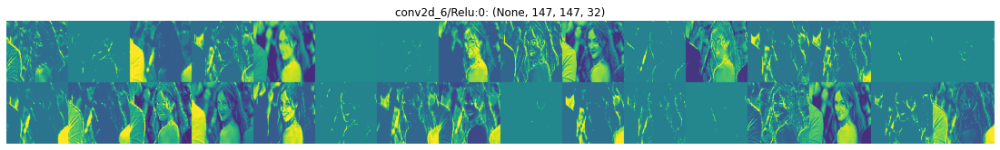

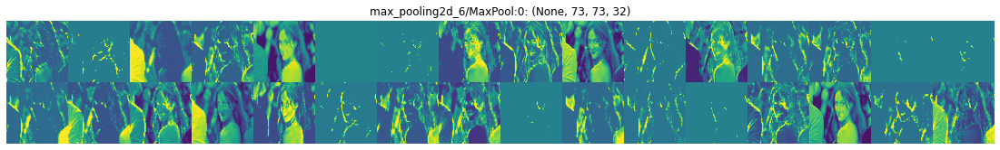

...

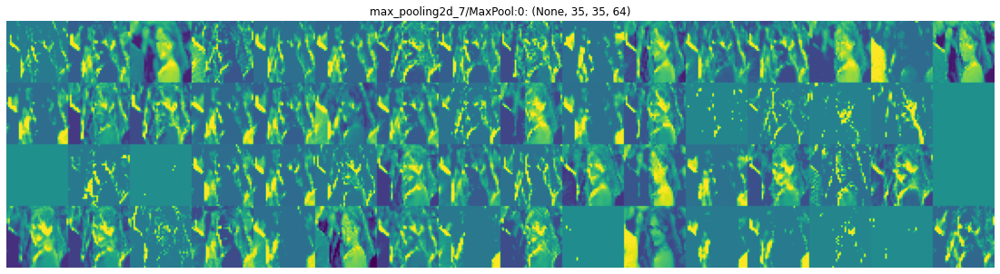

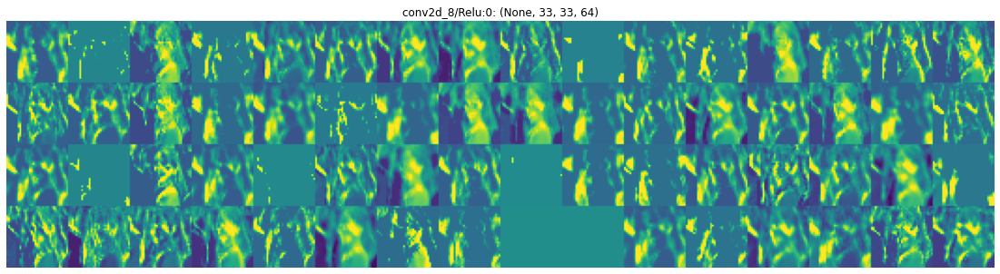

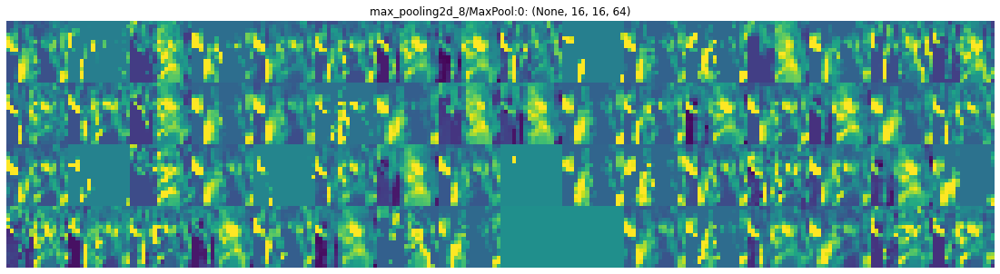

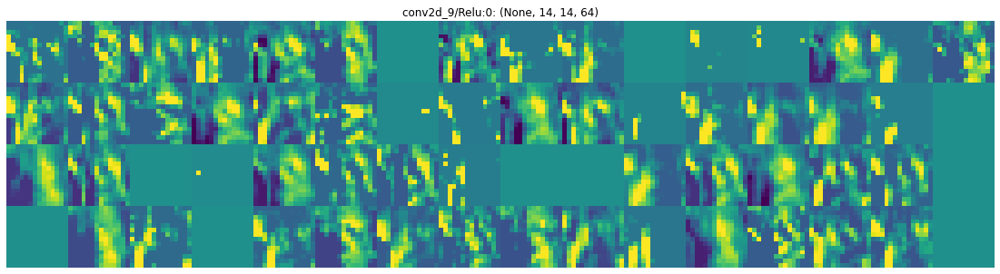

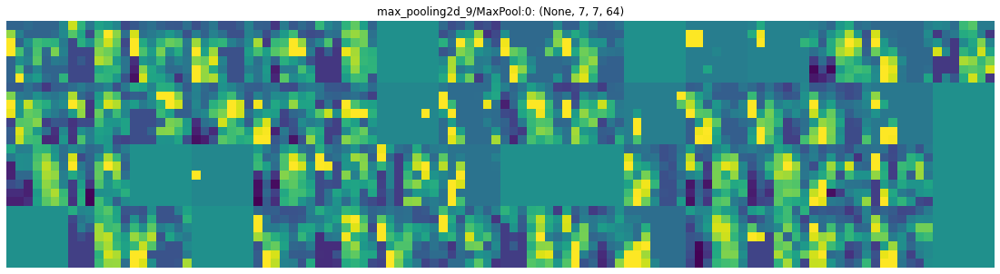

In [130]:
view_hh_layers('worst.jpg', 'test')

# Training with validation data set

In [140]:
from urllib import request

data_url = ('https://storage.googleapis.com/tensorflow-1-public/course2/week3/'
            'validation-horse-or-human.zip')
local_zip = os.path.join('data', 'horse-or-human-validation.zip')
response = request.urlretrieve(data_url, local_zip)
response

('horse-or-human-validation.zip', <http.client.HTTPMessage at 0x2a749d6be20>)

In [141]:
import zipfile

val_dir = os.path.join('data', 'horse-or-human-validation')
with zipfile.ZipFile(local_zip, 'r') as zip_ref:
    zip_ref.extractall(val_dir)

In [143]:
val_horse_dir = os.path.join(val_dir, 'horses')
val_human_dir = os.path.join(val_dir, 'humans')

val_horse_names = os.listdir(val_horse_dir)
val_human_names = os.listdir(val_human_dir)

print(f'There are {len(val_horse_names)} horse images.')
print(val_horse_names[:10])
print()
print(f'There are {len(val_human_names)} human images.')
print(val_human_names[:10])

There are 128 horse images.
['horse1-000.png', 'horse1-105.png', 'horse1-122.png', 'horse1-127.png', 'horse1-170.png', 'horse1-204.png', 'horse1-224.png', 'horse1-241.png', 'horse1-264.png', 'horse1-276.png']

There are 128 human images.
['valhuman01-00.png', 'valhuman01-01.png', 'valhuman01-02.png', 'valhuman01-03.png', 'valhuman01-04.png', 'valhuman01-05.png', 'valhuman01-06.png', 'valhuman01-07.png', 'valhuman01-08.png', 'valhuman01-09.png']


In [144]:
def view_horse_human_val(start_ind, nrows=4, ncols=4):
    fig, axs = plt.subplots(nrows, ncols, figsize=[4*ncols, 4*nrows])
    
    if nrows % 2 == 1:
        nrows += 1
    nimgs = (nrows // 2) * ncols
    horse_dirs = [os.path.join(val_horse_dir, file)
                  for file in val_horse_names[start_ind : start_ind+nimgs]]
    human_dirs = [os.path.join(val_human_dir, file)
                  for file in val_human_names[start_ind : start_ind+nimgs]]
    
    for ax, file in zip(axs.flatten(), horse_dirs+human_dirs):
        img = plt.imread(file)
        ax.imshow(img)
        ax.axis('off')

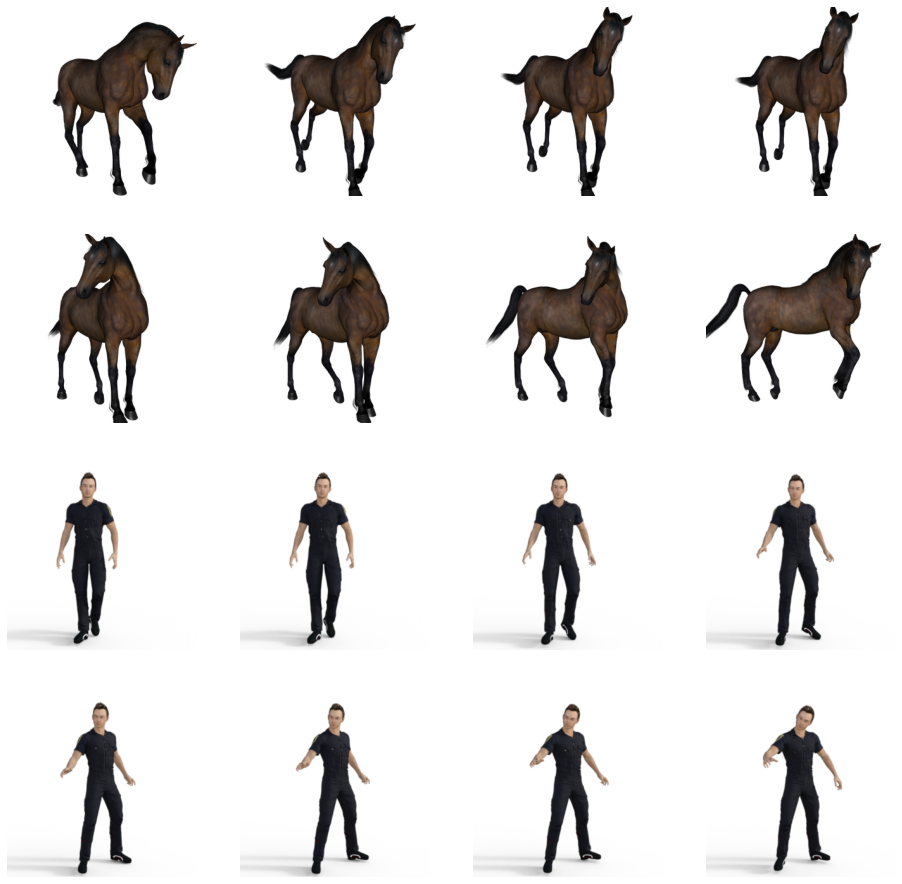

In [145]:
view_horse_human_val(0)

In [146]:
val_datagen = ImageDataGenerator(rescale=1/255)

val_data = val_datagen.flow_from_directory(
    val_dir,
    target_size=(300, 300),
    batch_size=32,
    class_mode='binary'
)

Found 256 images belonging to 2 classes.


In [147]:
model2 = keras.Sequential([
    keras.layers.Conv2D(16, (3, 3), input_shape=(300, 300, 3), activation='relu'),
    keras.layers.MaxPooling2D(2, 2),
    keras.layers.Conv2D(32, (3, 3), activation='relu'),
    keras.layers.MaxPooling2D(2, 2),
    keras.layers.Conv2D(64, (3, 3), activation='relu'),
    keras.layers.MaxPooling2D(2, 2),
    keras.layers.Conv2D(64, (3, 3), activation='relu'),
    keras.layers.MaxPooling2D(2, 2),
    keras.layers.Conv2D(64, (3, 3), activation='relu'),
    keras.layers.MaxPooling2D(2, 2),
    keras.layers.Flatten(),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

In [148]:
model2.compile(
    loss='binary_crossentropy',
    optimizer=keras.optimizers.RMSprop(learning_rate=0.001),
    metrics=['accuracy']
)

In [149]:
%%time

history = model2.fit(
    train_data,
    steps_per_epoch=8,
    epochs=15,
    verbose=1,
    validation_data=val_data,
    validation_steps=8
)

Epoch 1/15
8/8 [==============================] - 42s 5s/step - loss: 1.0971 - accuracy: 0.5328 - val_loss: 0.6920 - val_accuracy: 0.5000
Epoch 2/15
8/8 [==============================] - 40s 6s/step - loss: 0.6624 - accuracy: 0.6196 - val_loss: 0.7619 - val_accuracy: 0.5000
Epoch 3/15
8/8 [==============================] - 41s 5s/step - loss: 0.7927 - accuracy: 0.6251 - val_loss: 0.6485 - val_accuracy: 0.5000
Epoch 4/15
8/8 [==============================] - 44s 6s/step - loss: 0.5792 - accuracy: 0.6986 - val_loss: 0.7678 - val_accuracy: 0.6055
Epoch 5/15
8/8 [==============================] - 43s 5s/step - loss: 0.4797 - accuracy: 0.8265 - val_loss: 1.0870 - val_accuracy: 0.6875
Epoch 6/15
8/8 [==============================] - 44s 5s/step - loss: 0.4976 - accuracy: 0.8465 - val_loss: 1.4380 - val_accuracy: 0.7383
Epoch 7/15
8/8 [==============================] - 46s 7s/step - loss: 0.4482 - accuracy: 0.8476 - val_loss: 0.7158 - val_accuracy: 0.8516
Epoch 8/15
8/8 [==================

1/1 [==============================] - 0s 28ms/step


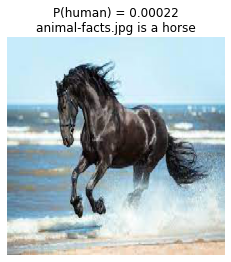

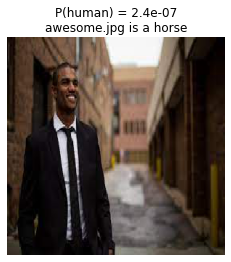

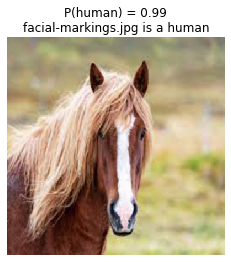

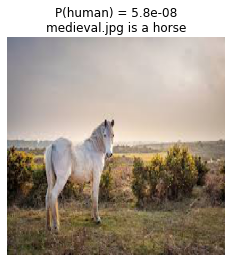

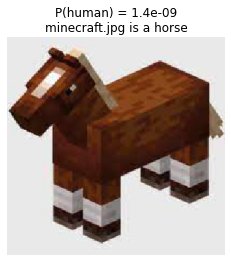

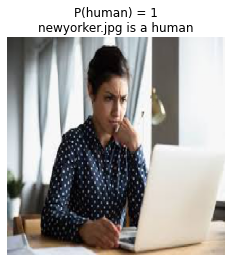

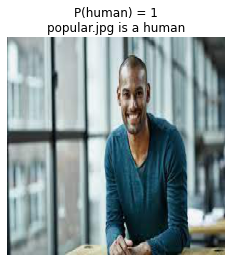

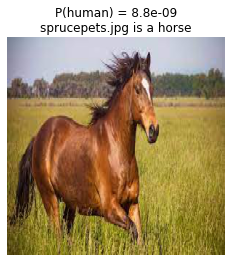

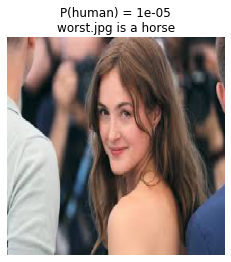

In [152]:
pred_horse_human_dir(model2)

In [157]:
view_hh_layers2 = get_layers_viewer(model2)

1/1 [==============================] - 0s 92ms/step


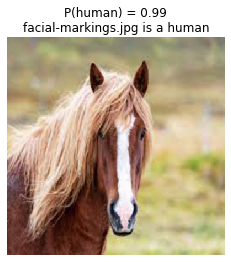

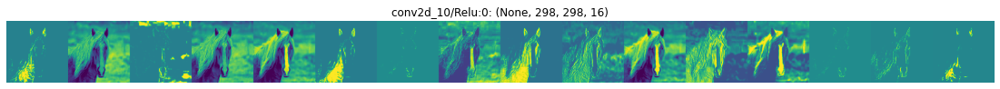

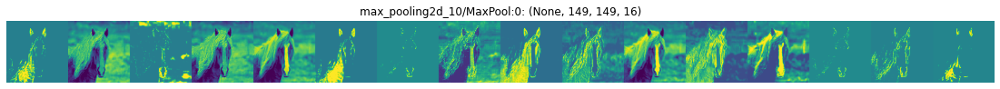

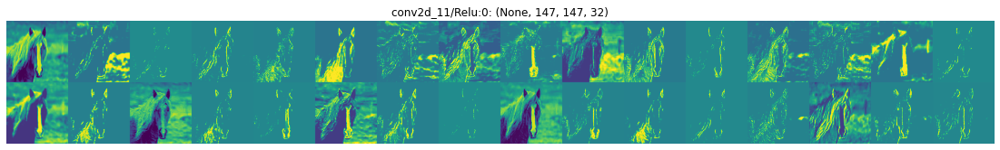

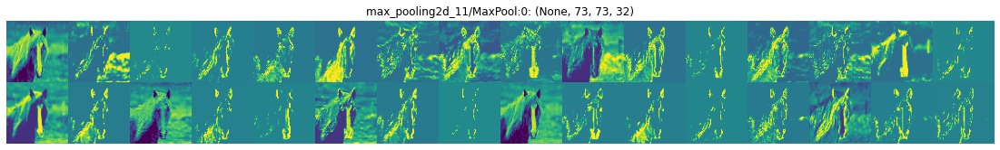

...

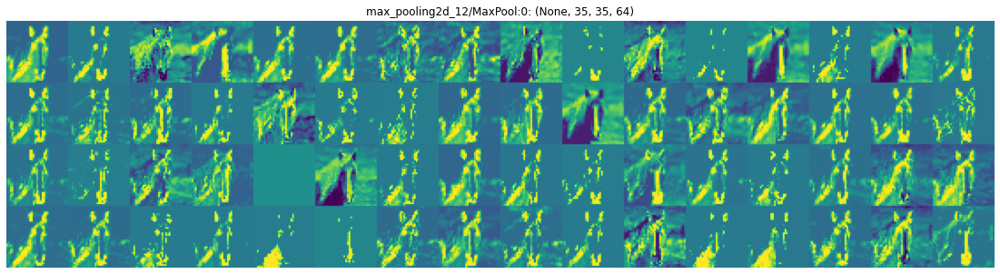

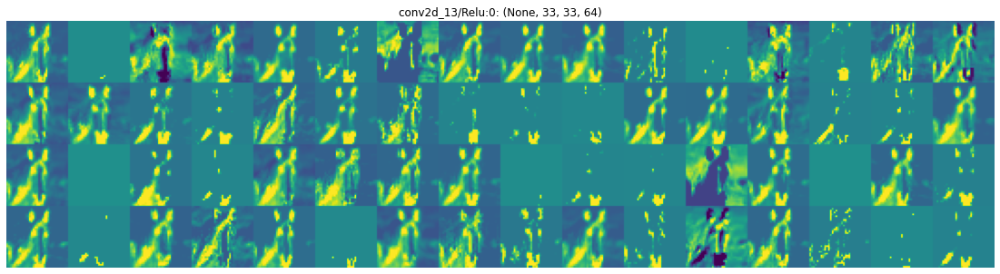

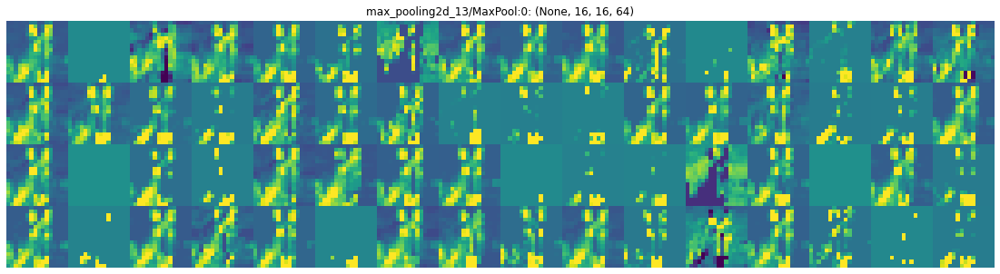

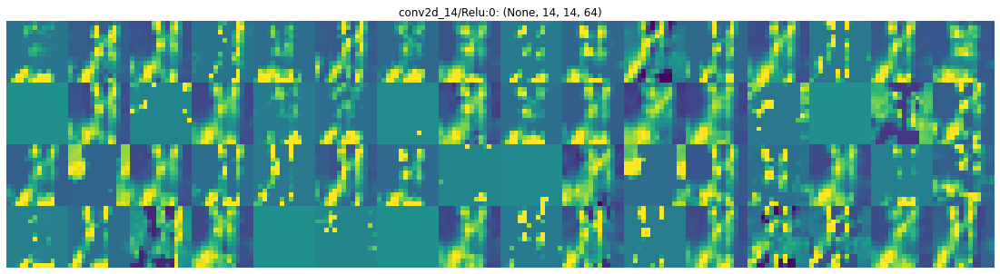

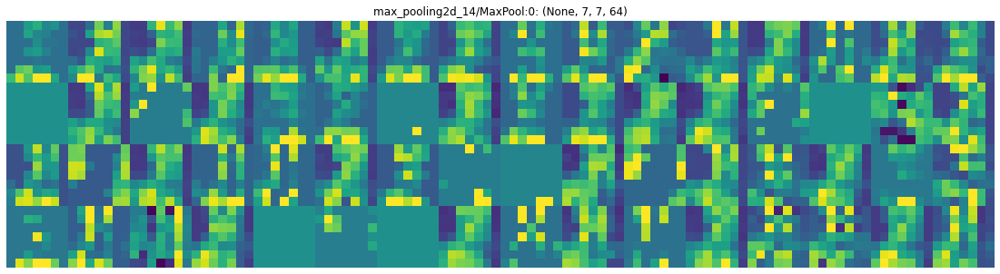

In [158]:
view_hh_layers2('facial-markings.jpg', 'test')

1/1 [==============================] - 0s 30ms/step


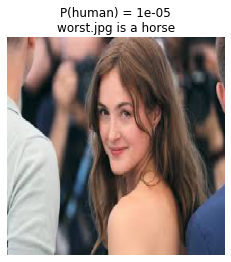

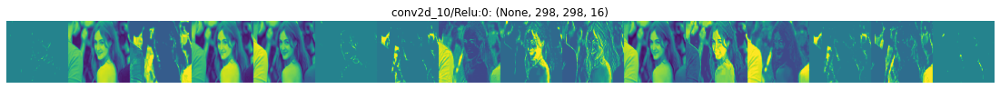

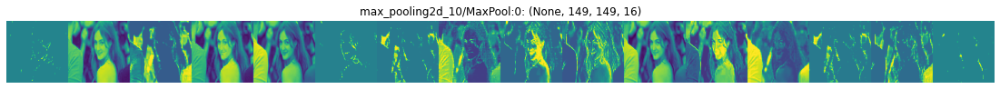

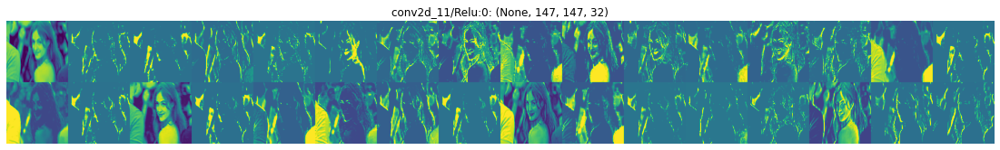

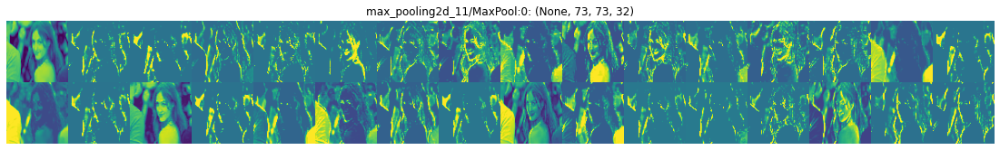

...

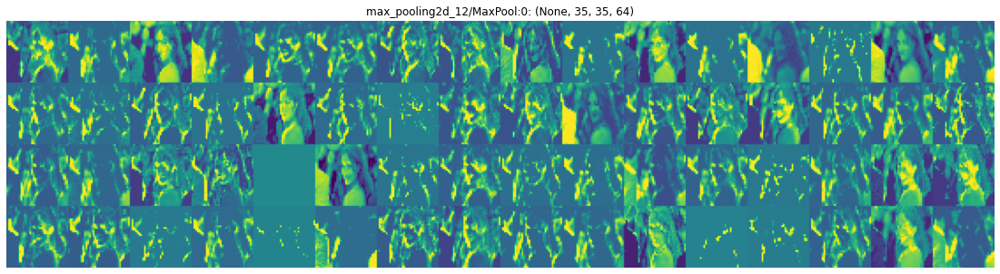

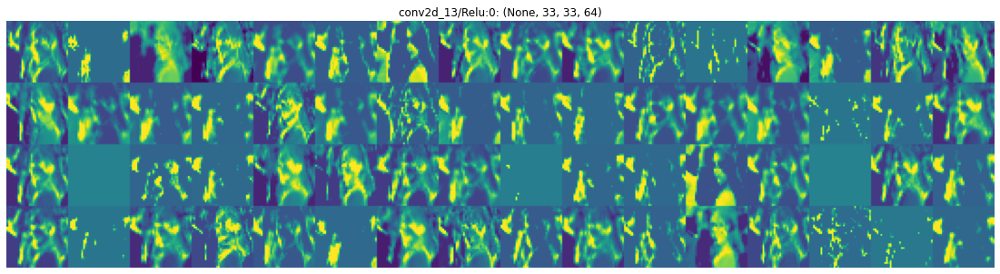

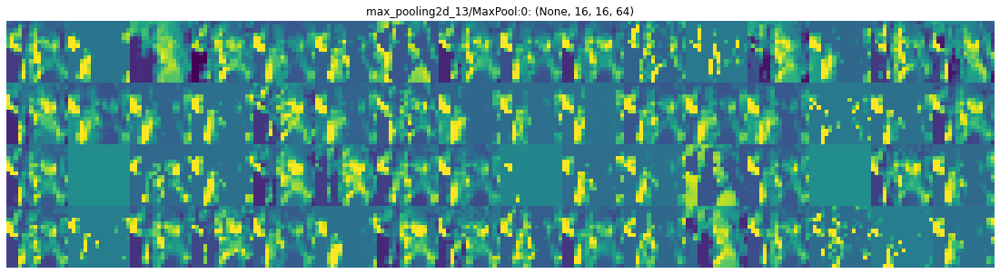

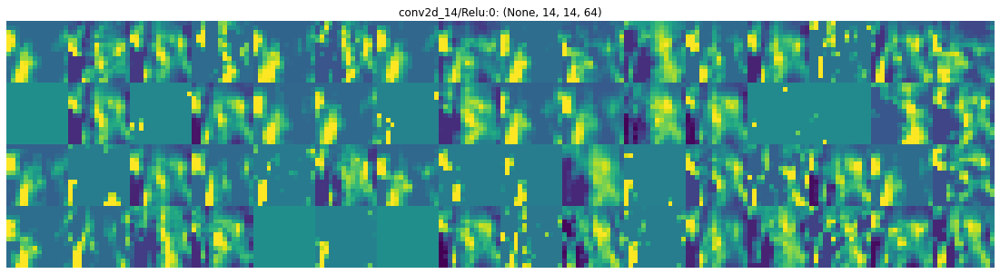

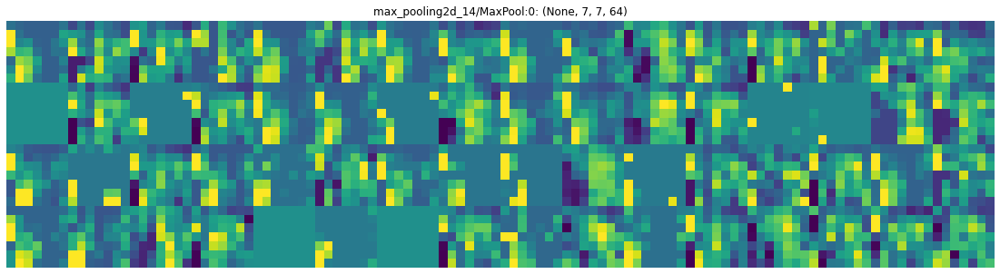

In [159]:
view_hh_layers2('worst.jpg', 'test')

# Training with downsized images

In [165]:
train_data = train_datagen.flow_from_directory(
    train_dir,
    target_size=(150, 150),
    batch_size=128,
    class_mode='binary'
)

val_data = val_datagen.flow_from_directory(
    val_dir,
    target_size=(150, 150),
    batch_size=32,
    class_mode='binary'
)

Found 1027 images belonging to 2 classes.
Found 256 images belonging to 2 classes.


In [175]:
model3 = keras.Sequential([
    keras.layers.Conv2D(16, (3, 3), input_shape=(150, 150, 3), activation='relu'),
    keras.layers.MaxPooling2D(2, 2),
    keras.layers.Conv2D(32, (3, 3), activation='relu'),
    keras.layers.MaxPooling2D(2, 2),
    keras.layers.Conv2D(64, (3, 3), activation='relu'),
    keras.layers.MaxPooling2D(2, 2),
    # keras.layers.Conv2D(64, (3, 3), activation='relu'),
    # keras.layers.MaxPooling2D(2, 2),
    # keras.layers.Conv2D(64, (3, 3), activation='relu'),
    # keras.layers.MaxPooling2D(2, 2),
    keras.layers.Flatten(),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dense(1, activation='sigmoid')
])

model3.summary()

model3.compile(
    loss='binary_crossentropy',
    optimizer=keras.optimizers.RMSprop(learning_rate=0.001),
    metrics=['accuracy']
)

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_23 (Conv2D)          (None, 148, 148, 16)      448       
                                                                 
 max_pooling2d_23 (MaxPoolin  (None, 74, 74, 16)       0         
 g2D)                                                            
                                                                 
 conv2d_24 (Conv2D)          (None, 72, 72, 32)        4640      
                                                                 
 max_pooling2d_24 (MaxPoolin  (None, 36, 36, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_25 (Conv2D)          (None, 34, 34, 64)        18496     
                                                                 
 max_pooling2d_25 (MaxPoolin  (None, 17, 17, 64)      

In [176]:
%%time

history = model3.fit(
    train_data,
    steps_per_epoch=8,
    epochs=15,
    verbose=1,
    validation_data=val_data,
    validation_steps=8
)

Epoch 1/15
8/8 [==============================] - 14s 2s/step - loss: 3.4571 - accuracy: 0.5628 - val_loss: 0.8766 - val_accuracy: 0.5000
Epoch 2/15
8/8 [==============================] - 13s 2s/step - loss: 0.9466 - accuracy: 0.6963 - val_loss: 0.5071 - val_accuracy: 0.7188
Epoch 3/15
8/8 [==============================] - 13s 2s/step - loss: 0.4183 - accuracy: 0.8420 - val_loss: 0.7777 - val_accuracy: 0.8359
Epoch 4/15
8/8 [==============================] - 13s 2s/step - loss: 0.2260 - accuracy: 0.9110 - val_loss: 1.0871 - val_accuracy: 0.8203
Epoch 5/15
8/8 [==============================] - 13s 2s/step - loss: 0.0995 - accuracy: 0.9611 - val_loss: 1.0540 - val_accuracy: 0.8516
Epoch 6/15
8/8 [==============================] - 13s 2s/step - loss: 0.1080 - accuracy: 0.9644 - val_loss: 1.5716 - val_accuracy: 0.7969
Epoch 7/15
8/8 [==============================] - 13s 2s/step - loss: 0.0556 - accuracy: 0.9800 - val_loss: 1.0031 - val_accuracy: 0.8789
Epoch 8/15
8/8 [==================

1/1 [==============================] - 0s 24ms/step


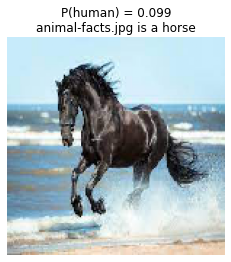

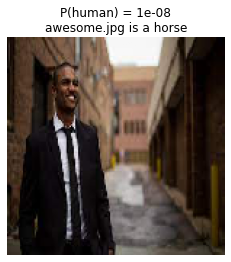

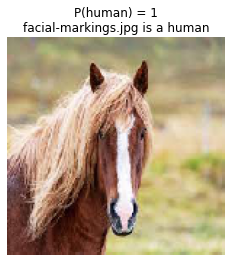

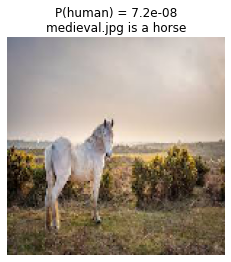

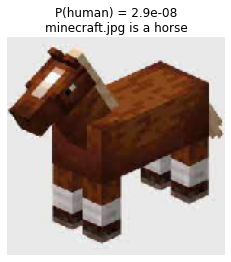

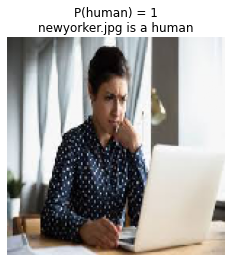

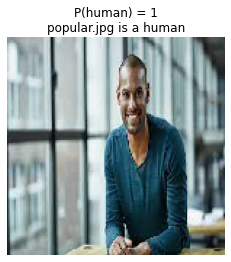

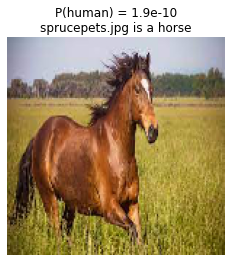

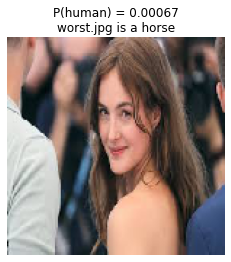

In [178]:
pred_horse_human_dir(model3)

In [179]:
view_hh_layers3 = get_layers_viewer(model3)

1/1 [==============================] - 0s 97ms/step


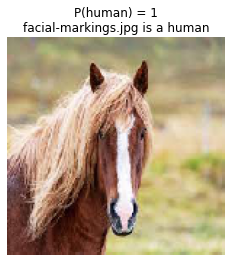

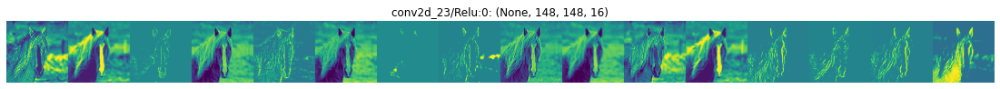

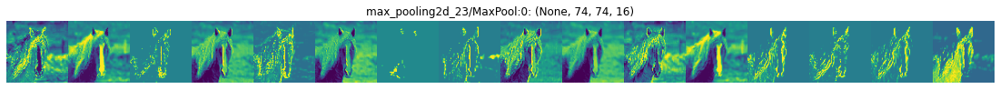

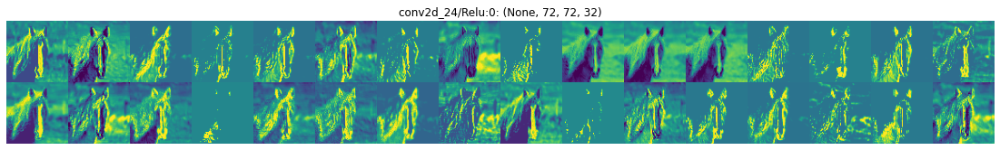

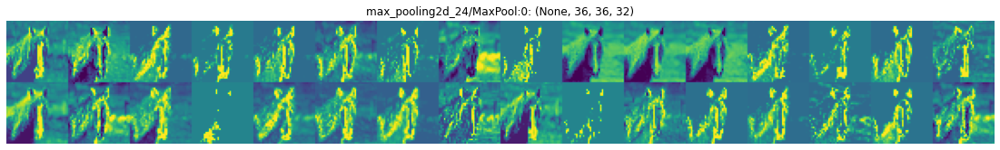

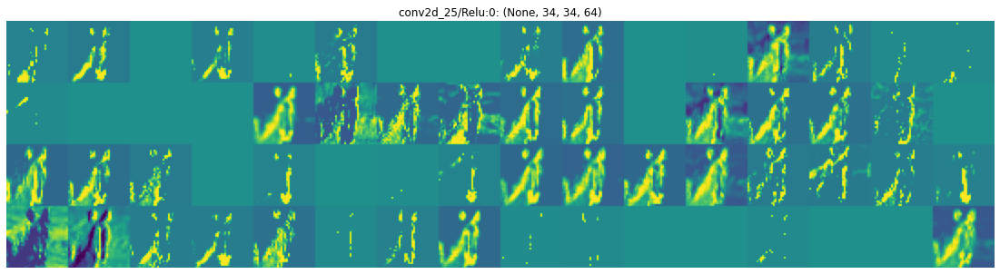

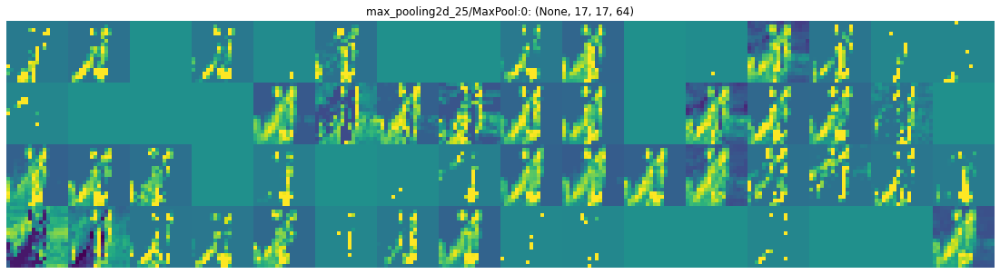

In [180]:
view_hh_layers3('facial-markings.jpg', 'test')

1/1 [==============================] - 0s 15ms/step


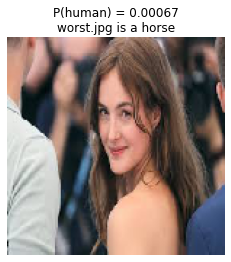

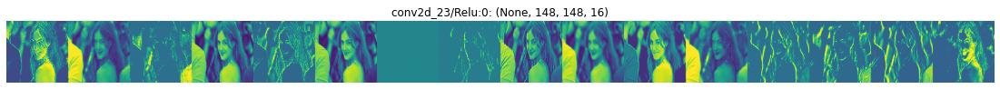

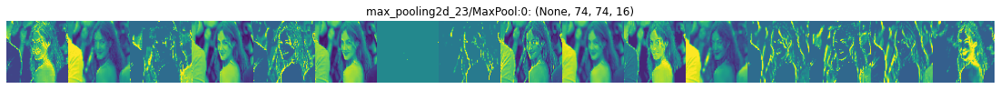

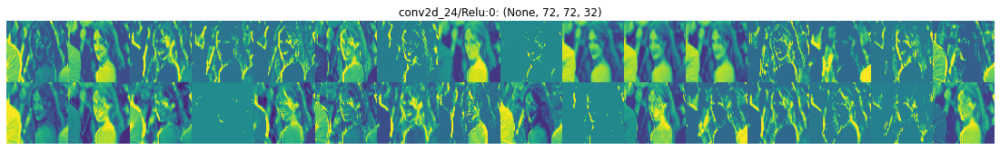

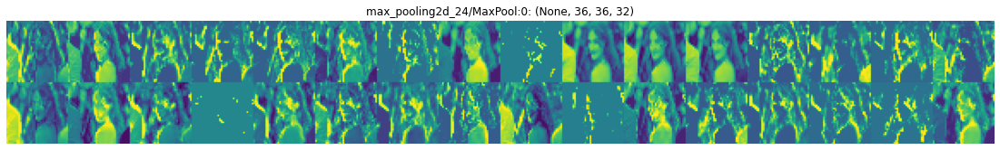

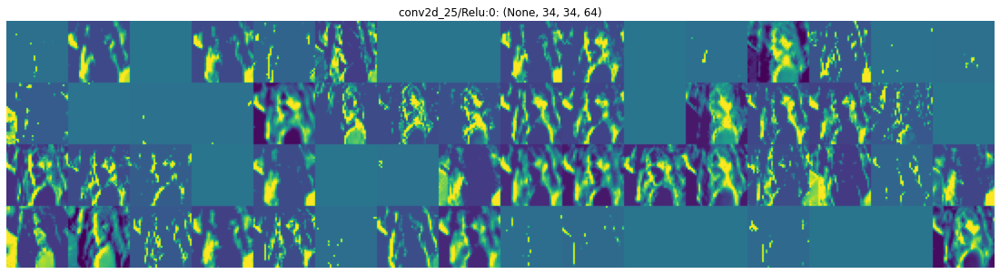

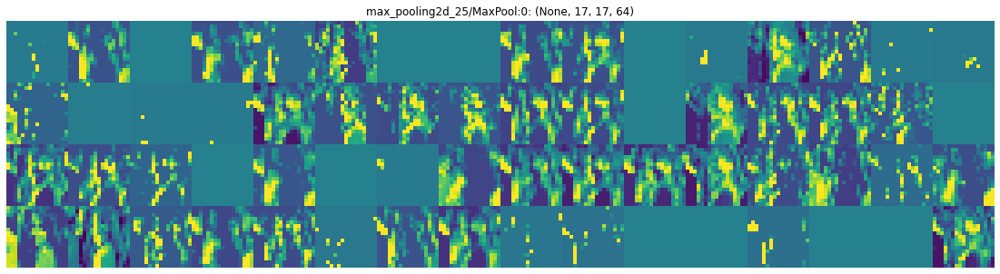

In [181]:
view_hh_layers3('worst.jpg', 'test')